<a href="https://colab.research.google.com/github/AyorindeTayo/Machine-Learning-classification-using-Decsision-tree/blob/main/Copy_of_Decision_tree.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:

from google.colab import files
files.upload()

Saving data21.xlsx to data21.xlsx


In [2]:
import pandas as pd

In [62]:
df=pd.read_excel('data21.xlsx')
df.head()

,Unnamed: 0,in_net_pnl,ishandiprd,oSide,pctA,AMPA,PMPA,AggPctSpread,PassPctSpread,pctOxprAcrossSpread,pctDecOSentOrAcrossSpread,SentExecAcrossSpreadDiff
0,0,42.905900,0.060634,1,0.001735,1.0,1,58.00,59.00,1.0,1.0,0.0
1,1,3.520796,0.028733,1,0.001099,1.0,1,20.00,21.00,1.0,1.0,0.0
2,2,-189.813389,0.029612,1,0.000792,1.0,1,5.00,6.00,1.0,1.0,0.0
3,3,28.849800,0.145503,1,0.001643,1.0,1,8.17,9.17,1.0,1.0,0.0
4,4,4.382800,0.100767,1,0.001355,1.0,1,12.00,13.00,1.0,1.0,0.0


In [63]:
data21=df

In [64]:
 #drop function which is used in removing or deleting rows or columns from the CSV files
data21.drop('Unnamed: 0', inplace=True, axis=1)
  
# display 
print("\nCSV Data after deleting the column 'Unnamed: 0':\n")
print(data21)


CSV Data after deleting the column 'Unnamed: 0':

        in_net_pnl  ishandiprd  oSide      pctA  AMPA  PMPA  AggPctSpread  \
0        42.905900    0.060634      1  0.001735  1.00     1         58.00   
1         3.520796    0.028733      1  0.001099  1.00     1         20.00   
2      -189.813389    0.029612      1  0.000792  1.00     1          5.00   
3        28.849800    0.145503      1  0.001643  1.00     1          8.17   
4         4.382800    0.100767      1  0.001355  1.00     1         12.00   
...            ...         ...    ...       ...   ...   ...           ...   
492740    0.000000    0.190131      1  0.000910  9.96     1          1.00   
492741    0.000000    0.190131      1  0.000910  9.97     1          1.00   
492742    0.000000    0.190131      1  0.000910  9.97     1          1.00   
492743   -0.744291    0.068779      1  0.000554  9.96     1          0.50   
492744   -0.558218    0.068779      1  0.000554  9.98     1          0.50   

        PassPctSpread  p

In [65]:

df

,in_net_pnl,ishandiprd,oSide,pctA,AMPA,PMPA,AggPctSpread,PassPctSpread,pctOxprAcrossSpread,pctDecOSentOrAcrossSpread,SentExecAcrossSpreadDiff
0,42.905900,0.060634,1,0.001735,1.00,1,58.00,59.00,1.0,1.000000,0.000000
1,3.520796,0.028733,1,0.001099,1.00,1,20.00,21.00,1.0,1.000000,0.000000
2,-189.813389,0.029612,1,0.000792,1.00,1,5.00,6.00,1.0,1.000000,0.000000
3,28.849800,0.145503,1,0.001643,1.00,1,8.17,9.17,1.0,1.000000,0.000000
4,4.382800,0.100767,1,0.001355,1.00,1,12.00,13.00,1.0,1.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...
492740,0.000000,0.190131,1,0.000910,9.96,1,1.00,2.00,0.5,0.666667,0.166667
492741,0.000000,0.190131,1,0.000910,9.97,1,1.00,2.00,0.5,0.666667,0.166667
492742,0.000000,0.190131,1,0.000910,9.97,1,1.00,2.00,0.5,0.666667,0.166667
492743,-0.744291,0.068779,1,0.000554,9.96,1,0.50,1.50,0.5,0.500000,0.000000


In [66]:
pip install rfc


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [67]:
data21.columns

Index(['in_net_pnl', 'ishandiprd', 'oSide', 'pctA', 'AMPA', 'PMPA',
       'AggPctSpread', 'PassPctSpread', 'pctOxprAcrossSpread',
       'pctDecOSentOrAcrossSpread', 'SentExecAcrossSpreadDiff'],
      dtype='object')

In [68]:
import numpy as np 
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
# To change scientific numbers to float
np.set_printoptions(formatter={'float_kind':'{:f}'.format})

# Increases the size of sns plots
sns.set(rc={'figure.figsize':(8,6)})

# Datetime lib
from pandas import to_datetime
import itertools
import warnings
import datetime
warnings.filterwarnings('ignore')

from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, r2_score



**Splitting the Raw Data - Hold-out validation**

In [69]:
# Your code goes here
X = data21.drop('in_net_pnl', axis=1).values# Input features (attributes)
y = data21['in_net_pnl'].values # Target vector
print('X shape: {}'.format(np.shape(X)))
print('y shape: {}'.format(np.shape(y)))

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.9, test_size=0.1, random_state=0)

X shape: (492745, 10)
y shape: (492745,)


In [70]:
import pandas as pd
from sklearn.tree import DecisionTreeRegressor

In [71]:
regressor = DecisionTreeRegressor(random_state = 2022, max_depth=3)

In [72]:
regressor.fit(X, y)

DecisionTreeRegressor(max_depth=3, random_state=2022)

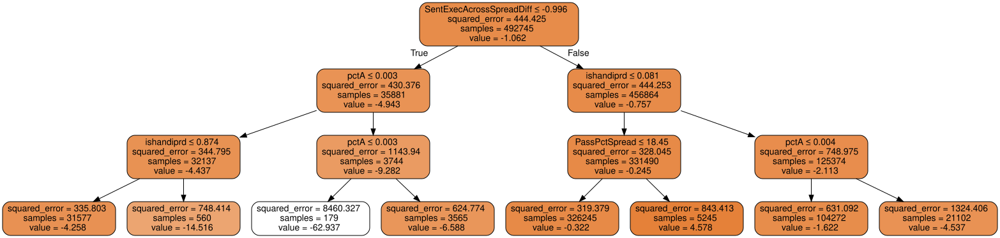

In [14]:
import graphviz 

dot_data = tree.export_graphviz(regressor, out_file=None, 
    feature_names=data21.drop('in_net_pnl', axis=1).columns,    
    class_names=data21['in_net_pnl'].unique().astype(str),  
    filled=True, rounded=True,  
    special_characters=True)
graph = graphviz.Source(dot_data)
graph





In [73]:
!pip install -q dtreeviz

In [74]:
!apt-get install graphviz

Reading package lists... Done
Building dependency tree       
Reading state information... Done
graphviz is already the newest version (2.40.1-2).
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 62 not upgraded.


In [75]:
from dtreeviz.trees import *



In [76]:
import matplotlib.font_manager

In [77]:
df['cumulative in_net_pnl'] = df['in_net_pnl'].cumsum()
print(df)

        in_net_pnl  ishandiprd  oSide      pctA  AMPA  PMPA  AggPctSpread  \
0        42.905900    0.060634      1  0.001735  1.00     1         58.00   
1         3.520796    0.028733      1  0.001099  1.00     1         20.00   
2      -189.813389    0.029612      1  0.000792  1.00     1          5.00   
3        28.849800    0.145503      1  0.001643  1.00     1          8.17   
4         4.382800    0.100767      1  0.001355  1.00     1         12.00   
...            ...         ...    ...       ...   ...   ...           ...   
492740    0.000000    0.190131      1  0.000910  9.96     1          1.00   
492741    0.000000    0.190131      1  0.000910  9.97     1          1.00   
492742    0.000000    0.190131      1  0.000910  9.97     1          1.00   
492743   -0.744291    0.068779      1  0.000554  9.96     1          0.50   
492744   -0.558218    0.068779      1  0.000554  9.98     1          0.50   

        PassPctSpread  pctOxprAcrossSpread  pctDecOSentOrAcrossSpread  \
0 

In [78]:
df['cumulative in_net_pnl'] 

0             42.905900
1             46.426696
2           -143.386693
3           -114.536893
4           -110.154093
              ...      
492740   -523358.016979
492741   -523358.016979
492742   -523358.016979
492743   -523358.761270
492744   -523359.319489
Name: cumulative in_net_pnl, Length: 492745, dtype: float64

In [79]:
df.head()

,in_net_pnl,ishandiprd,oSide,pctA,AMPA,PMPA,AggPctSpread,PassPctSpread,pctOxprAcrossSpread,pctDecOSentOrAcrossSpread,SentExecAcrossSpreadDiff,cumulative in_net_pnl
0,42.905900,0.060634,1,0.001735,1.0,1,58.00,59.00,1.0,1.0,0.0,42.905900
1,3.520796,0.028733,1,0.001099,1.0,1,20.00,21.00,1.0,1.0,0.0,46.426696
2,-189.813389,0.029612,1,0.000792,1.0,1,5.00,6.00,1.0,1.0,0.0,-143.386693
3,28.849800,0.145503,1,0.001643,1.0,1,8.17,9.17,1.0,1.0,0.0,-114.536893
4,4.382800,0.100767,1,0.001355,1.0,1,12.00,13.00,1.0,1.0,0.0,-110.154093


In [80]:

# To get 10000 random rows
# each time it gives 3 different rows
 
# df.sample(10000) or
data31=df.sample(n = 10000)

In [81]:
# Your code goes here
X = data31.drop('cumulative in_net_pnl', axis=1).values# Input features (attributes)
y = data31['cumulative in_net_pnl'].values # Target vector
print('X shape: {}'.format(np.shape(X)))
print('y shape: {}'.format(np.shape(y)))

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.9, test_size=0.1, random_state=0)

X shape: (10000, 11)
y shape: (10000,)


In [82]:
import pandas as pd
from sklearn.tree import DecisionTreeRegressor

In [83]:
regressor = DecisionTreeRegressor(random_state = 2022, max_depth=3)

In [84]:
regressor.fit(X, y)

DecisionTreeRegressor(max_depth=3, random_state=2022)

In [85]:
regr= tree.DecisionTreeRegressor(max_depth=6) 
regr.fit(X,y,)
viz = dtreeviz(regr,
               X,
               y,
               target_name=X,
               feature_names=y,
               title="Stock Market Regression",
               fontname="Arial",
               colors = {"title":"purple"},
               scale=1)
viz

In [52]:
data31.columns

Index(['in_net_pnl', 'ishandiprd', 'oSide', 'pctA', 'AMPA', 'PMPA',
       'AggPctSpread', 'PassPctSpread', 'pctOxprAcrossSpread',
       'pctDecOSentOrAcrossSpread', 'SentExecAcrossSpreadDiff',
       'cummulative in_net_pnl', 'cumulative in_net_pnl'],
      dtype='object')

In [86]:
viz = dtreeviz(regressor,
               X,
               y,
               target_name='cumulative in_net_pnl',
               feature_names=['ishandiprd', 'oSide', 'pctA', 'AMPA', 'PMPA','AggPctSpread', 'PassPctSpread', 'pctOxprAcrossSpread','pctDecOSentOrAcrossSpread', 'SentExecAcrossSpreadDiff'])
viz